# Bankruptcy Model

Cristian Castro

*Winter Semester 2021/2022*

In [1]:
# Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

## Data Exploration

In [2]:
df_orig = pd.read_csv("/Users/cristiancastro/Desktop/Projects/BankruptcyAnalysis_MLProject/project-data/bankruptcy.csv")
df_orig.head()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,...,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
0,0.174190,0.41299,0.14371,1.3480,-28.9820,0.60383,0.219460,1.1225,1.1961,0.46359,...,0.163960,0.375740,0.83604,0.000007,9.7145,6.2813,84.291,4.3303,4.0341,b'0'
1,0.146240,0.46038,0.28230,1.6294,2.5952,0.00000,0.171850,1.1721,1.6018,0.53962,...,0.027516,0.271000,0.90108,0.000000,5.9882,4.1103,102.190,3.5716,5.9500,b'0'
2,0.000595,0.22612,0.48839,3.1599,84.8740,0.19114,0.004572,2.9881,1.0077,0.67566,...,0.007639,0.000881,0.99236,0.000000,6.7742,3.7922,64.846,5.6287,4.4581,b'0'
3,0.024526,0.43236,0.27546,1.7833,-10.1050,0.56944,0.024526,1.3057,1.0509,0.56453,...,0.048398,0.043445,0.95160,0.142980,4.2286,5.0528,98.783,3.6950,3.4844,b'0'
4,0.188290,0.41504,0.34231,1.9279,-58.2740,0.00000,0.233580,1.4094,1.3393,0.58496,...,0.176480,0.321880,0.82635,0.073039,2.5912,7.0756,100.540,3.6303,4.6375,b'0'


In [3]:
df_orig.tail()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,...,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
10498,0.002861,0.58067,-0.223860,0.51658,-31.866,0.002861,0.002861,0.618550,1.01200,0.359170,...,0.011834,0.007966,0.98817,0.32736,38.1420,39.1500,42.202,8.6489,5.2646,b'1'
10499,-0.051968,0.55254,0.147150,2.16980,12.748,-0.051968,-0.034361,0.669830,0.94694,0.370110,...,-0.056037,-0.140410,1.05600,1.15300,14.4930,9.2851,32.761,11.1410,1.9276,b'1'
10500,-0.135900,0.83954,-0.342010,0.46526,-145.310,-0.219120,-0.131860,0.191130,1.09990,0.160460,...,0.144120,-0.846930,0.85427,0.81420,6.2737,9.6966,212.230,1.7198,1.5659,b'1'
10501,0.009423,0.50028,0.261630,1.52300,-10.158,0.009423,0.007700,0.989900,1.01230,0.495230,...,0.012186,0.019027,0.98781,0.00000,5.9675,4.3536,98.240,3.7154,7.8068,b'1'
10502,-0.001775,0.94780,0.003729,1.00450,-50.221,0.000000,0.002565,0.055122,2.12680,0.052245,...,0.023492,-0.033971,0.97208,2.39850,7.5512,3.9960,141.160,2.5857,12.2250,b'1'


In [4]:
# Display all rows, all columns when exploring
pd.set_option("display.max_rows",None)
pd.set_option("display.max_columns",None)

In [5]:
# Working Dataframe and types
df = df_orig.copy(deep=True)
df.dtypes

Attr1     float64
Attr2     float64
Attr3     float64
Attr4     float64
Attr5     float64
Attr6     float64
Attr7     float64
Attr8     float64
Attr9     float64
Attr10    float64
Attr11    float64
Attr12    float64
Attr13    float64
Attr14    float64
Attr15    float64
Attr16    float64
Attr17    float64
Attr18    float64
Attr19    float64
Attr20    float64
Attr21    float64
Attr22    float64
Attr23    float64
Attr24    float64
Attr25    float64
Attr26    float64
Attr27    float64
Attr28    float64
Attr29    float64
Attr30    float64
Attr31    float64
Attr32    float64
Attr33    float64
Attr34    float64
Attr35    float64
Attr36    float64
Attr37    float64
Attr38    float64
Attr39    float64
Attr40    float64
Attr41    float64
Attr42    float64
Attr43    float64
Attr44    float64
Attr45    float64
Attr46    float64
Attr47    float64
Attr48    float64
Attr49    float64
Attr50    float64
Attr51    float64
Attr52    float64
Attr53    float64
Attr54    float64
Attr55    float64
Attr56    

In [6]:
# Descriptive Statistics
df.describe()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,10503.000000,10503.000000,10503.000000,10485.000000,1.047800e+04,10503.000000,10503.000000,10489.000000,10500.000000,10503.000000,10503.000000,10485.000000,10460.000000,10503.000000,1.049500e+04,10489.000000,10489.000000,10503.000000,10460.000000,10460.000000,9696.000000,10503.000000,10460.000000,10276.000000,10503.000000,10489.000000,9.788000e+03,10275.000000,10503.000000,10460.000000,10460.000000,1.040200e+04,10485.000000,10489.000000,10503.000000,10503.000000,5767.000000,10503.000000,10460.000000,10485.000000,10301.000000,10460.000000,10460.000000,10460.000000,9912.000000,10485.000000,1.041700e+04,10503.000000,10460.000000,10489.000000,10503.000000,10417.000000,10275.000000,10275.000000,1.050300e+04,10460.000000,10503.000000,10474.000000,10503.000000,9.911000e+03,10486.000000,1.046000e+04,10485.000000,10275.000000
mean,0.052844,0.619911,0.095490,9.980499,-1.347662e+03,-0.121159,0.065624,19.140113,1.819254,0.366093,0.086764,2.411266,0.376563,0.065634,3.004332e+03,2.729654,20.511539,0.070739,-0.170778,68.448531,4.670725,0.075676,-0.176466,0.211936,0.196153,2.580730,1.185945e+03,6.092884,3.921179,0.459346,-0.177084,1.171670e+03,8.419887,5.398356,0.071075,1.981250,102.697692,0.465510,-0.076355,2.381026,28.707178,-0.141671,195.389286,126.940260,17.451297,8.978029,5.424888e+02,0.004834,-0.217844,8.686024,0.497135,11.244158,5.725829,6.708568,6.638549e+03,-0.530082,-0.014817,3.848794,1.429319,5.713363e+02,13.935361,1.355370e+02,9.095149,35.766800
std,0.647797,6.427041,6.420056,523.691951,1.185806e+05,6.970625,0.651152,717.756745,7.581659,6.428603,0.655407,111.459642,49.675550,0.651151,1.091981e+05,110.233475,721.812766,0.835328,11.210201,1083.699904,305.897238,0.581734,11.149274,2.093845,6.742161,108.823993,3.469123e+04,94.713753,0.840528,71.755042,11.157003,6.841270e+04,37.696764,69.035263,0.572124,2.630705,2469.447679,6.425362,8.079334,37.819839,2845.290346,10.787555,3303.309554,2766.505503,1720.342176,523.565601,3.126416e+04,0.629770,11.910935,522.528325,6.420885,851.867915,89.708042,93.511530,5.989196e+04,55.978608,18.684047,190.201224,77.273270,3.715967e+04,83.704103,2.599116e+04,31.419096,428.298315
min,-17.692000,0.000000,-479.730000,0.002080,-1.190300e+07,-508.120000,-17.692000,-2.081800,-1.215700,-479.730000,-17.692000,-1543.800000,-631.710000,-17.692000,-2.321800e+06,-204.300000,-0.043411,-17.692000,-771.650000,-0.001439,-1.107500,-17.692000,-771.650000,-60.742000,-500.750000,-204.300000,-1.901300e+05,-690.400000,-0.358530,-6351.700000,-771.390000,-9.295600e+03,-1.921900,-1696.000000,-17.073000,-0.000084,-2.200900,-479.730000,-551.110000,-7.081900,-667.730000,-765.800000,-25113.000000,-25113.000000,-74385.000000,-6.469200,-1.730300e+01,-17.692000,-905.750000,0.002080,0.000000,-25.467000,-869.040000,-706.490000,-7.513800e+05,-5691.700000,-1667.300000,-198.690000,-172.070000,0.000000e+00,-6.590300,-2.336500e+06,-0.000156,-0.000102
25%,0.000686,0.253955,0.017461,1.040100,-5.207075e+01,0.000000,0.002118,0.431270,1.011275,0.297340,0.009809,0.006183,0.020740,0.002131,1.865950e+02,0.060302,1.449200,0.002131,0.001648,14.253750,0.796673,0.000000,0.000556,0.014938,0.135695,0.055067,0.000000e+00,0.027178,3.393200,0.073850,0.004012,4.471900e+01,2.785900,0.367460,0.001730,1.043500,1.038600,0.426810,0.001557,0.053666,0.022026,0.000000,65.627250,34.214750,0.006157,0.602830,1.494100e+01,-0.048988,-0.036186,0.749370,0.177200,0.122470,0.667285,0.950435,1.462100e+01,0.005137,0.006796,0.875560,0.000000,5.533150e+00,4.486075,4.073700e+01,3.062800,2.023350
50%,0.043034,0.464140,0.198560,1.605600,1.579300e+

In [7]:
df[df.isna().any(axis=1)]

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
1,0.146240,0.460380,0.282300,1.629400,2.595200e+00,0.000000e+00,0.171850,1.172100,1.601800,0.539620,0.175790,0.383170,0.126470,0.171850,8.294600e+02,0.440040,2.172100,0.171850,0.107280,60.954000,5.088900,0.175710,0.091295,NaN,0.175230,0.384420,4.459300e+01,1.048600,4.079200,0.243840,0.109740,1.050900e+02,3.473300,3.383600,4.407600e-02,1.601800,NaN,0.539620,2.751600e-02,1.640600e-01,0.074333,0.109690,149.75000,88.801000,0.546690,1.033000,6.267800e+01,0.144970,0.090503,1.587400,0.448490,0.287910,2.004400,2.004400,3.387800e+03,0.027516,0.271000,9.010800e-01,0.000000,5.988200e+00,4.110300,1.021900e+02,3.571600,5.950000,b'0'
2,0.000595,0.226120,0.488390,3.159900,8.487400e+01,1.911400e-01,0.004572,2.988100,1.007700,0.675660,0.004572,0.020219,0.030966,0.004572,2.094100e+03,0.174300,4.422500,0.004572,0.003592,53.881000,0.674510,0.040610,0.000468,0.234700,0.675660,0.156720,3.215300e-01,1.710700,4.622000,0.036196,0.003592,6.534500e+01,5.585700,0.179600,4.061000e-02,1.342500,NaN,0.675660,3.190700e-02,8.446900e-01,0.098528,0.031907,150.13000,96.251000,0.003168,2.329000,5.429600e+01,0.005769,0.004533,3.159900,0.226120,0.179030,2.366700,2.366700,2.045300e+04,0.007639,0.000881,9.923600e-01,0.000000,6.774200e+00,3.792200,6.484600e+01,5.628700,4.458100,b'0'
5,0.182060,0.556150,0.321910,1.604500,1.631400e+01,0.000000e+00,0.182060,0.798080,1.812600,0.443850,0.207660,0.341880,0.271630,0.182060,4.123000e+02,0.885280,1.798100,0.182060,0.100450,43.168000,1.272400,0.000000,0.100450,NaN,0.416000,0.885280,0.000000e+00,2.211800,3.810400,0.299260,0.228770,2.414100e+02,1.512000,1.447800,2.953800e-02,1.812600,49.017000,0.456910,1.629600e-02,1.856000e-01,0.059746,0.000000,152.16000,108.990000,0.849300,1.201900,9.717700e+01,-0.310280,-0.171190,1.536400,0.532540,0.661400,3.049600,3.139300,2.080600e+03,0.555770,0.410190,4.695700e-01,0.029421,8.455300e+00,3.348800,1.072400e+02,3.403600,12.454000,b'0'
8,0.238950,0.554730,0.406970,1.760900,-2.290700e+01,0.000000e+00,0.297140,0.802680,2.331700,0.445270,0.330610,0.555530,0.131980,0.297140,6.579500e+02,0.554750,1.802700,0.297140,0.127430,81.972000,1.046700,0.330150,0.102480,NaN,0.439130,0.449850,9.863300e+00,6.998300,3.911000,0.202110,0.138360,9.740000e+01,3.747400,3.613300,3.273200e-01,2.331700,21.065000,0.465120,1.403800e-01,1.750700e-01,0.054265,0.141590,132.77000,50.802000,0.456300,0.781820,9.535900e+01,0.319550,0.137040,1.697800,0.534880,0.266850,7.656900,7.998300,3.315200e+03,0.140380,0.536630,8.729200e-01,0.044584,4.452700e+00,7.184700,8.372700e+01,4.359400,40.097000,b'0'
9,-0.119860,0.607330,0.041368,1.068800,-3.759500e+01,-4.479700e-01,-0.119860,0.646550,3.000000,0.392670,-0.119860,-0.199300,0.011424,-0.119860,6.467900e+03,0.056432,1.646600,-0.119860,-0.039953,28.419000,0.858000,0.000000,-0.039953,NaN,-0.520780,0.056432,NaN,0.115810,3.332200,0.193860,-0.079906,9.945600e+01,3.670000,3.634200,6.949300e-03,3.000000,NaN,0.392670,2.316400e-03,7.971900e-02,0.131340,0.000000,72.37200,43.953000,-0.513150,0.680400,3.862700e+01,-0.154130,-0.051377,1.058400,0.601420,0.272480,1.099300,1.099300,8.889900e+01,0.264280,-0.305250,7.374900e-01,0.000000,1.284400e+01,8.304300,7.317200e+01,4.988300,8.398400,b'0'
10,-0.130350,0.089680,0.149070,2.662200,-3.400300e+01,-2.085600e-01,-0.124780,8.979100,0.761340,0.805240,-0.124780,-1.391400,-0.025158,-0.124780,-2.864900e+03,-0.127410,11.151000,-0.124780,-0.274750,148.050000,0.682660,-0.124610,-0.287010,-0.195420,0.805240,-0.189460,-2.088900e+00,0.195820,4.025900,0.186710,-0.274750,5.487300e+01,6.651700,-1.389500,-1.246100e-01,0.501970,NaN,0.80524

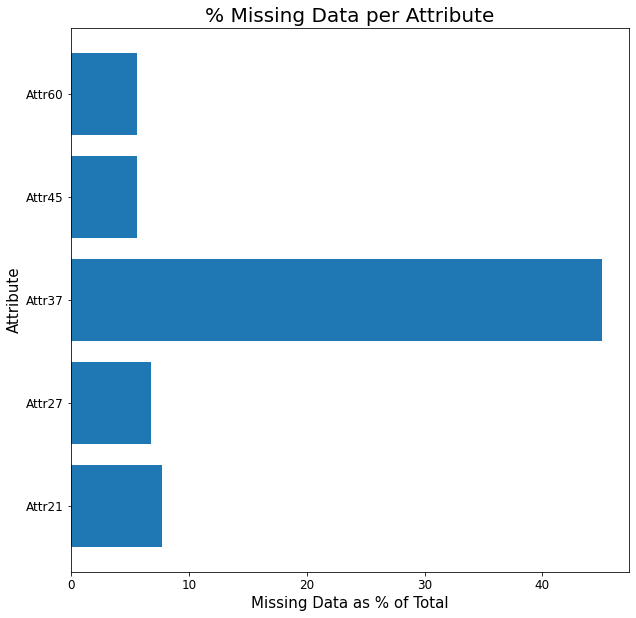

In [8]:
# First lets count for missing data per attribute
perc_md = 100*(len(df.index)-df.count())/len(df.index)

# Count only the attributes with more than 5% missing data
perc_md = perc_md[perc_md > 5]
x = perc_md.index.values
y = perc_md.values

# Graphically
plt.figure(figsize=(10,10))
plt.barh(x,y)
plt.title('% Missing Data per Attribute', fontsize=20)
plt.ylabel('Attribute', fontsize=15)
plt.xlabel('Missing Data as % of Total', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Most of the attributes show less than 10% of missing data. This can be handled. But Attribute 37 exhibit > 40% of missing data. This attribute is called: "(Current Assets-Inventories)/Long-Term Liabilities".

### Checking for Collinearities

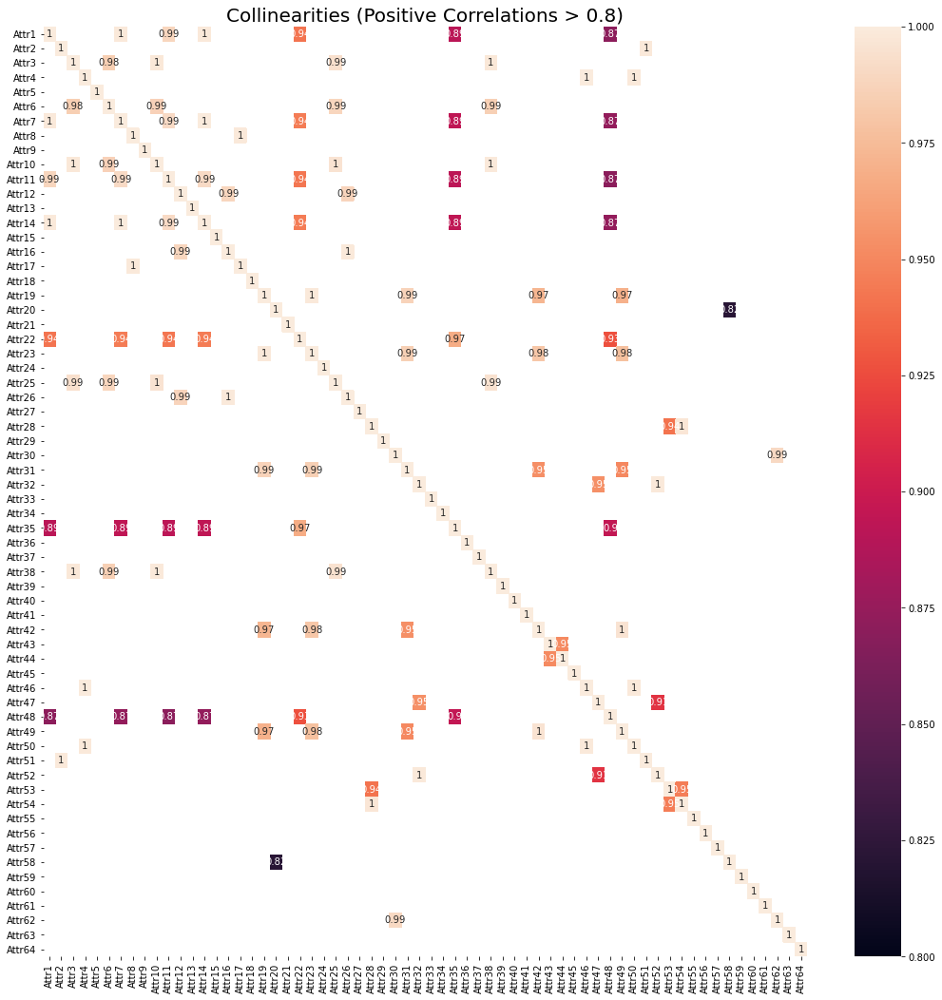

In [9]:
# Big Picture: Positive Correlations
corr_mat = df.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat>0.8], vmin = 0.8, vmax = 1, annot=True)
ax.set_title('Collinearities (Positive Correlations > 0.8)', fontsize=20)
plt.show()

There are many attributes that seems to be in collinearity with each other, with a positive correlation. This must be assessed in detail.

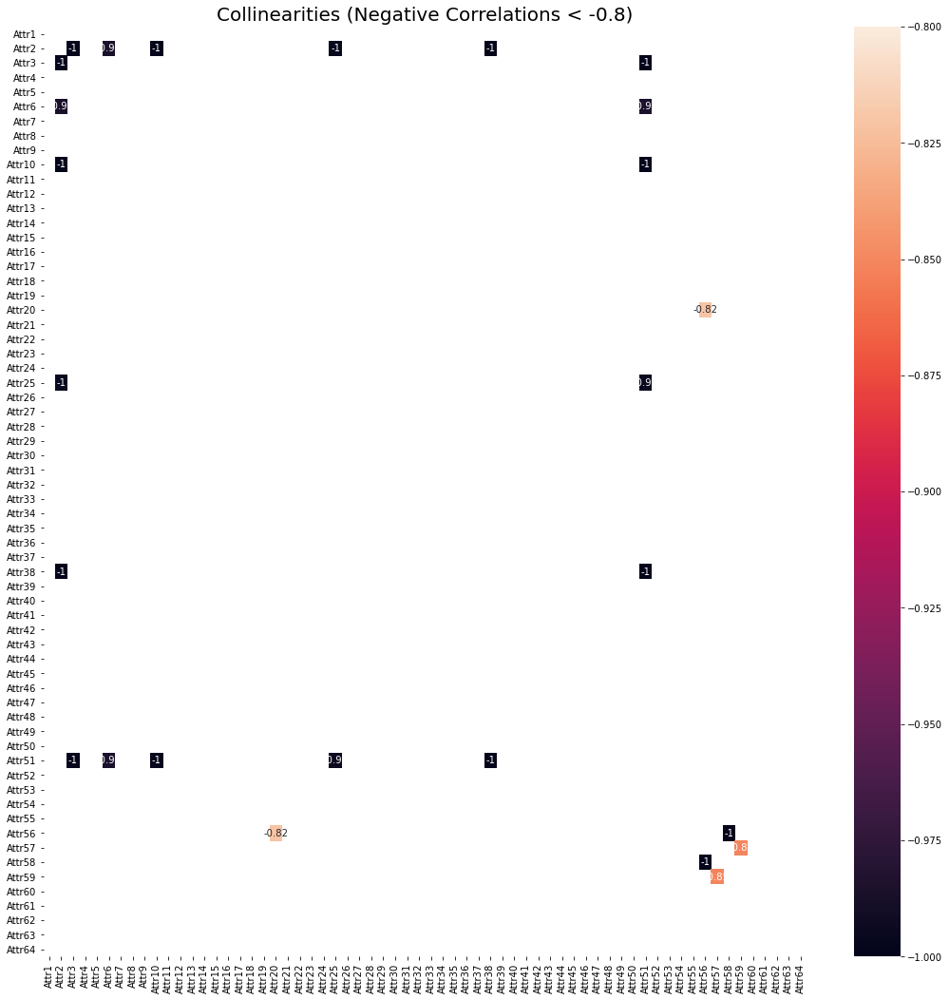

In [10]:
# Big Picture: Negative Correlations
corr_mat = df.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat<-0.8], vmin = -1, vmax = -0.8, annot=True)
ax.set_title('Collinearities (Negative Correlations < -0.8)', fontsize=20)
plt.show()

There are many attributes that seems to be in collinearity with each other, with a negative correlation. This must be assessed in detail.

In [11]:
# Check especifically for collinearities
corr_mat = df.corr()

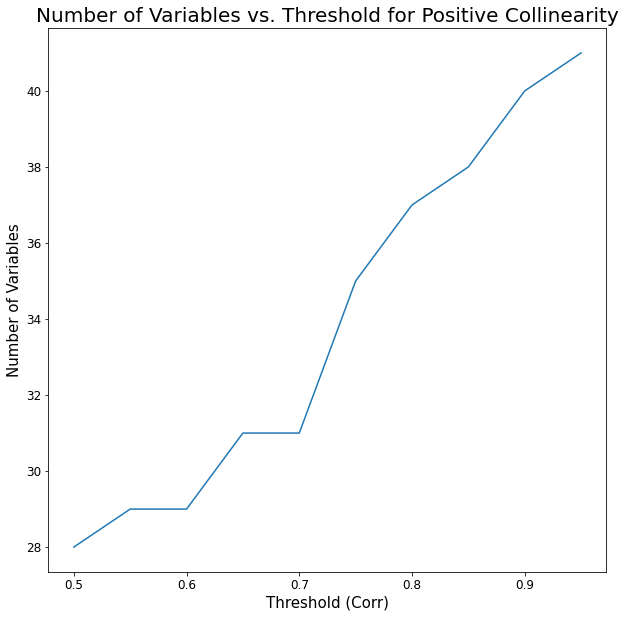

In [12]:
# The number of variables to pick is depending on the threshold for collinearity
# Check graphically

threshold_range = [0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95]
threshold_ = []
variables_ = []

for threshold in threshold_range:
    countclus = 0
    cumulative_ = []
    for i in range(1,65):
        name = "Attr"+str(i)

        if name not in cumulative_:
            countclus = countclus + 1
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][corr_mat[name]>threshold].round(decimals=3)
            clus["Count"] = df.count()[clus.index]
            cumulative_.extend(clus.index)
    
    threshold_.append(threshold)
    variables_.append(countclus)

plt.figure(figsize=(10,10))
plt.plot(threshold_,variables_)
plt.title('Number of Variables vs. Threshold for Positive Collinearity', fontsize=20)
plt.ylabel('Number of Variables', fontsize=15)
plt.xlabel('Threshold (Corr)', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

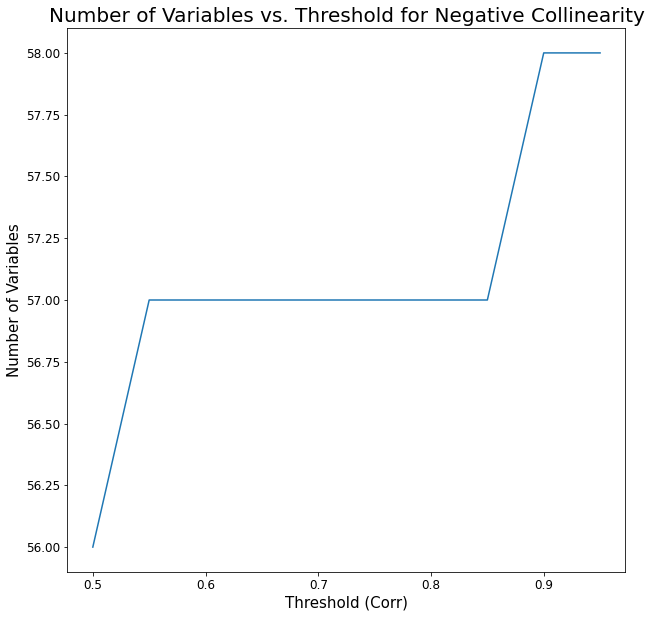

In [13]:
# The number of variables to pick is depending on the threshold for collinearity
# Check graphically

threshold_range = [0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95]
threshold_ = []
variables_ = []

for threshold in threshold_range:
    countclus = 0
    cumulative_ = []
    for i in range(1,65):
        name = "Attr"+str(i)

        if name not in cumulative_:
            countclus = countclus + 1
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][corr_mat[name]<-threshold].round(decimals=3)
            clus["Count"] = df.count()[clus.index]
            cumulative_.extend(clus.index)
    
    threshold_.append(threshold)
    variables_.append(countclus)

plt.figure(figsize=(10,10))
plt.plot(threshold_,variables_)
plt.title('Number of Variables vs. Threshold for Negative Collinearity', fontsize=20)
plt.ylabel('Number of Variables', fontsize=15)
plt.xlabel('Threshold (Corr)', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Base on collinearity:
- 8 variables can be deleted for having collinearity with high negative correlation (< -0.85)
- if we use a threshold of 0.88, 25 variables can be deleted.

In sum, it seems we will have a total of 31 predictors. Nonetheless we need to check in detail by group.

In [64]:
# Let's check for the collinearity with positive correlation
threshold = 0.88

cumulative_ = []
countclus = 0

for i in range(1,65):
    name = "Attr"+str(i)
    
    if name not in cumulative_:
        countclus = countclus + 1
        clus = pd.DataFrame()
        clus["Corr"] = corr_mat[name][corr_mat[name]>threshold].round(decimals=3)
        clus["Count"] = df.count()[clus.index]
        cumulative_.extend(clus.index)
        print(clus,"\n")

print("Number of Variables to Use: ",countclus)

         Corr  Count
Attr1   1.000  10503
Attr7   0.999  10503
Attr11  0.989  10503
Attr14  0.999  10503
Attr22  0.942  10503
Attr35  0.892  10503 

         Corr  Count
Attr2   1.000  10503
Attr51  0.999  10503 

         Corr  Count
Attr3   1.000  10503
Attr6   0.985  10503
Attr10  0.998  10503
Attr25  0.994  10503
Attr38  0.998  10503 

         Corr  Count
Attr4   1.000  10485
Attr46  1.000  10485
Attr50  0.999  10489 

       Corr  Count
Attr5   1.0  10478 

         Corr  Count
Attr8   1.000  10489
Attr17  0.999  10489 

       Corr  Count
Attr9   1.0  10500 

         Corr  Count
Attr12  1.000  10485
Attr16  0.989  10489
Attr26  0.988  10489 

        Corr  Count
Attr13   1.0  10460 

        Corr  Count
Attr15   1.0  10495 

        Corr  Count
Attr18   1.0  10503 

         Corr  Count
Attr19  1.000  10460
Attr23  0.999  10460
Attr31  0.987  10460
Attr42  0.973  10460
Attr49  0.970  10460 

        Corr  Count
Attr20   1.0  10460 

        Corr  Count
Attr21   1.0   9696 

   

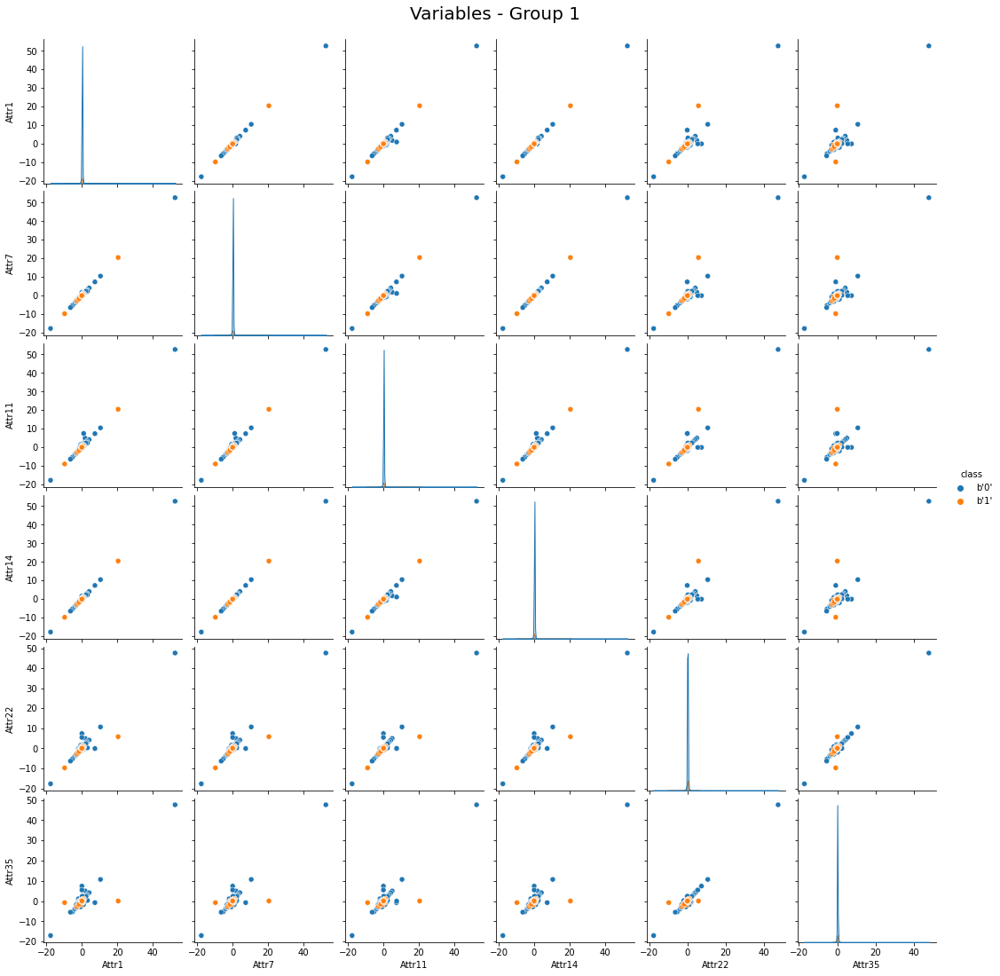

In [15]:
# Pairplot for Variables-Group 1
df_ = df[["Attr1","Attr7","Attr11","Attr14","Attr22","Attr35","class"]]
ax = sns.pairplot(df_.dropna(), hue="class")
ax.fig.suptitle("Variables - Group 1", y = 1.02, fontsize = 20)
plt.show()

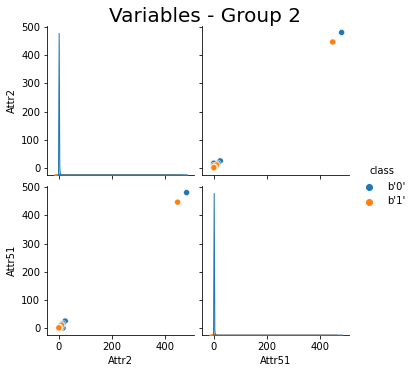

In [16]:
# Pairplot for Variables-Group 2
df_ = df[["Attr2","Attr51","class"]]
ax = sns.pairplot(df_.dropna(), hue="class")
ax.fig.suptitle("Variables - Group 2", y = 1.02, fontsize = 20)
plt.show()

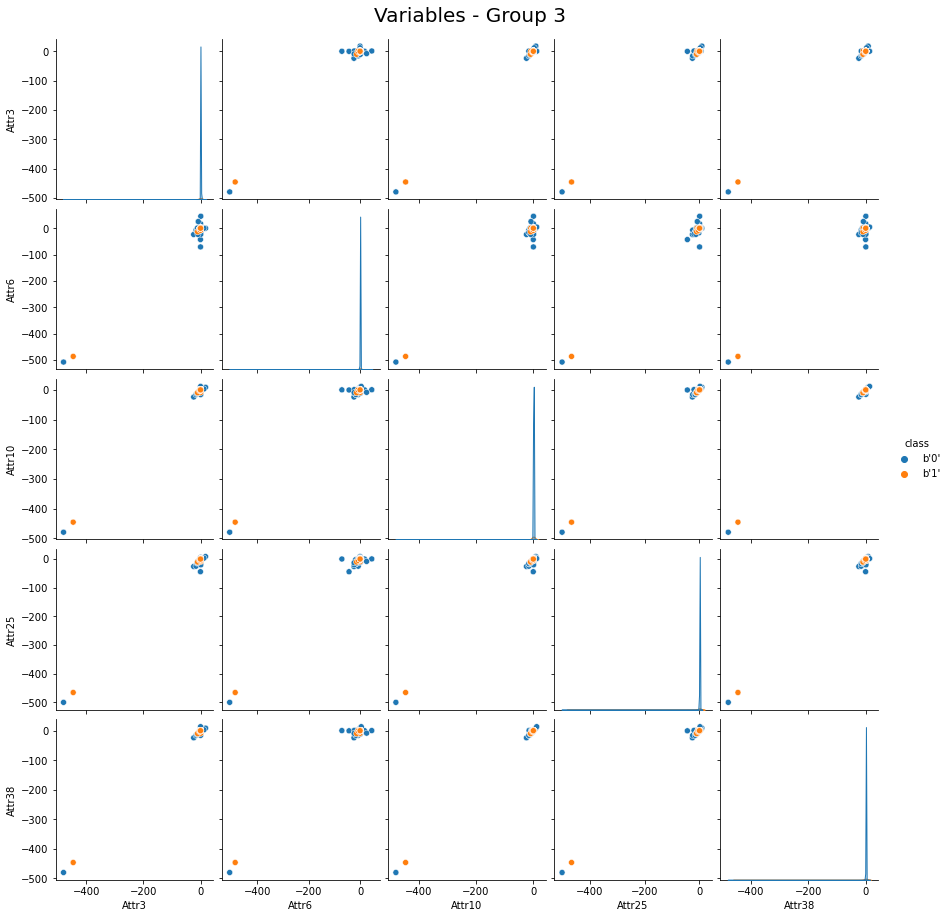

In [17]:
# Pairplot for Variables-Group 3
df_ = df[["Attr3","Attr6","Attr10", "Attr25", "Attr38","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 3", y = 1.02, fontsize = 20)
plt.show()

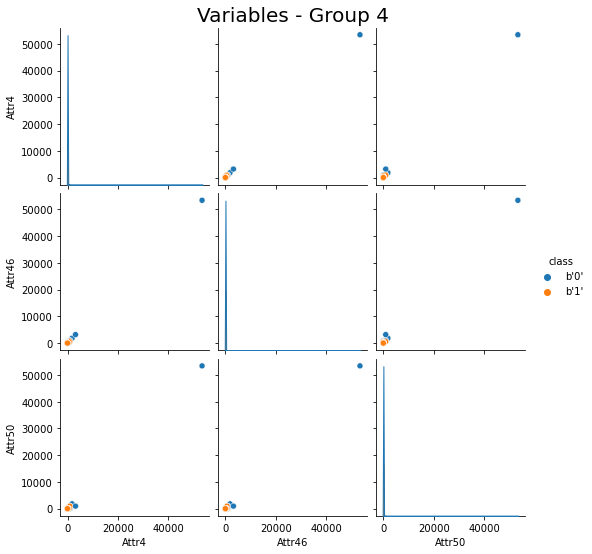

In [18]:
# Pairplot for Variables-Group 4
df_ = df[["Attr4","Attr46","Attr50","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 4", y = 1.02, fontsize = 20)
plt.show()

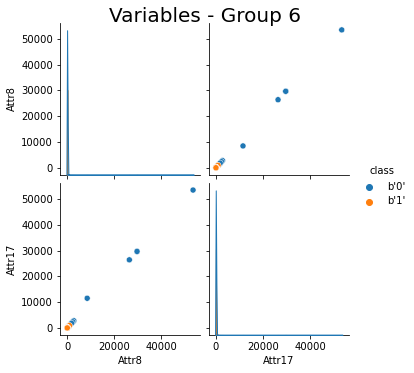

In [19]:
# Pairplot for Variables-Group 6
df_ = df[["Attr8","Attr17","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 6", y = 1.02, fontsize = 20)
plt.show()

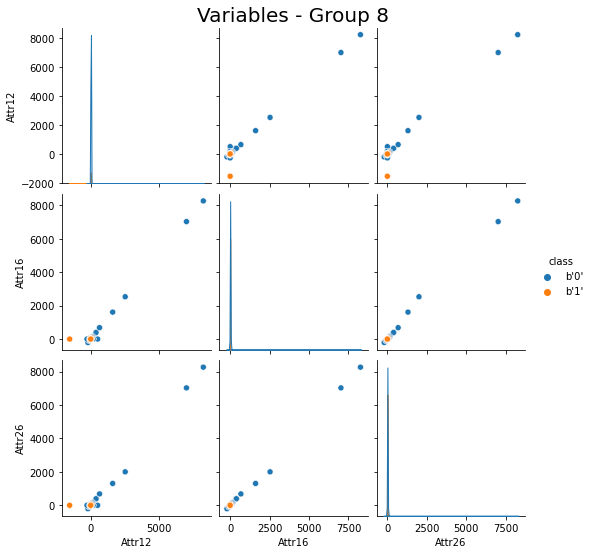

In [20]:
# Pairplot for Variables-Group 8
df_ = df[["Attr12","Attr16","Attr26","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 8", y = 1.02, fontsize = 20)
plt.show()

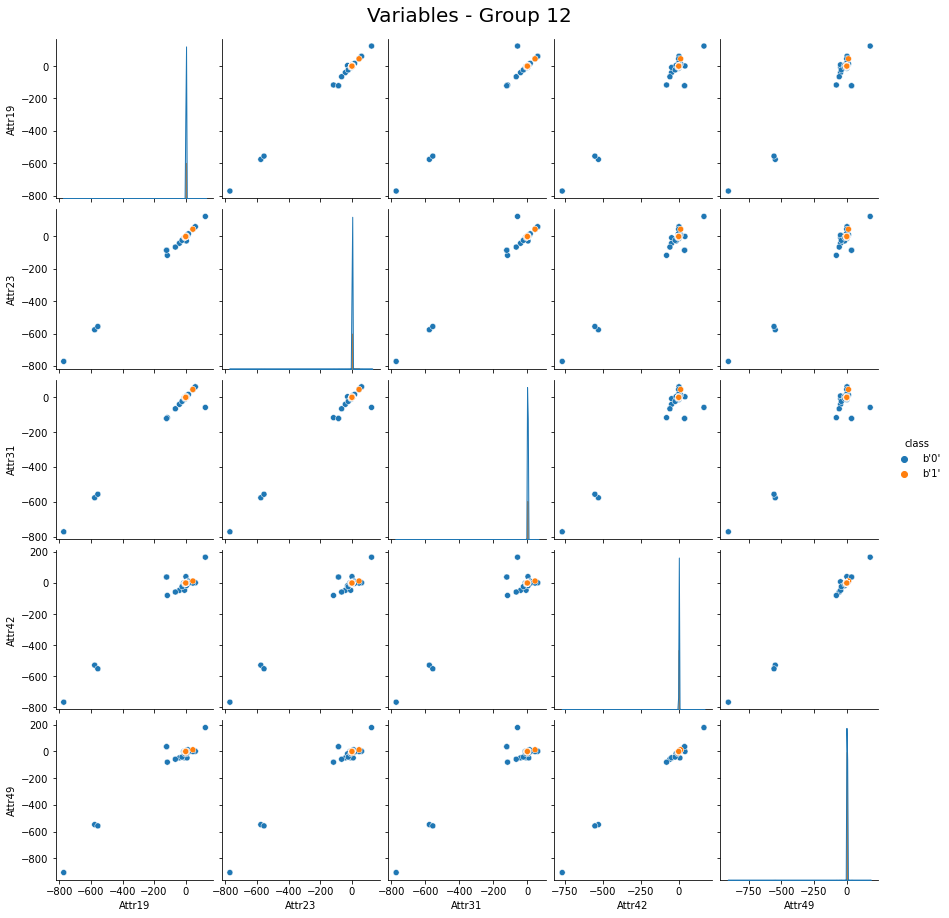

In [21]:
# Pairplot for Variables-Group 12
df_ = df[["Attr19","Attr23","Attr31","Attr42","Attr49","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 12", y = 1.02, fontsize = 20)
plt.show()

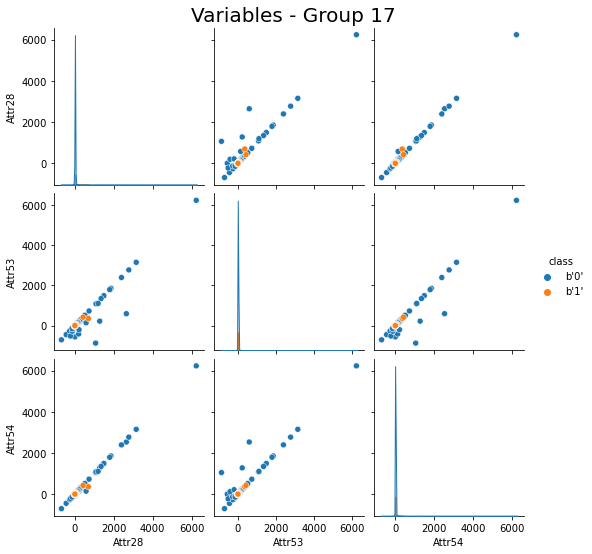

In [22]:
# Pairplot for Variables-Group 17
df_ = df[["Attr28","Attr53","Attr54","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 17", y = 1.02, fontsize = 20)
plt.show()

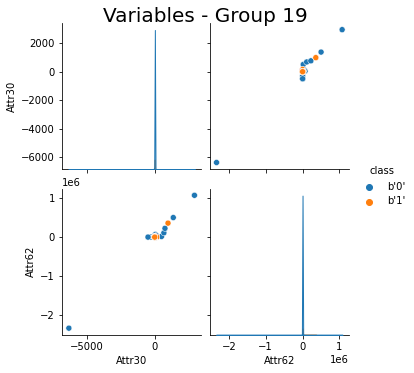

In [23]:
# Pairplot for Variables-Group 19
df_ = df[["Attr30","Attr62","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 19", y = 1.02, fontsize = 20)
plt.show()

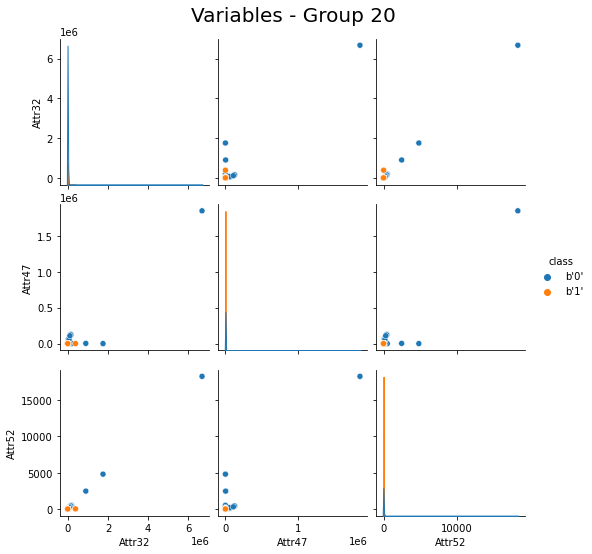

In [24]:
# Pairplot for Variables-Group 20
df_ = df[["Attr32","Attr47","Attr52","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 20", y = 1.02, fontsize = 20)
plt.show()

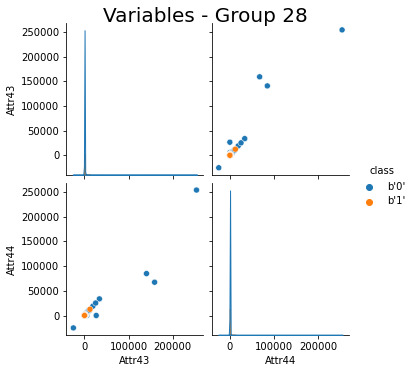

In [25]:
# Pairplot for Variables-Group 28
df_ = df[["Attr43","Attr44","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 28", y = 1.02, fontsize = 20)
plt.show()

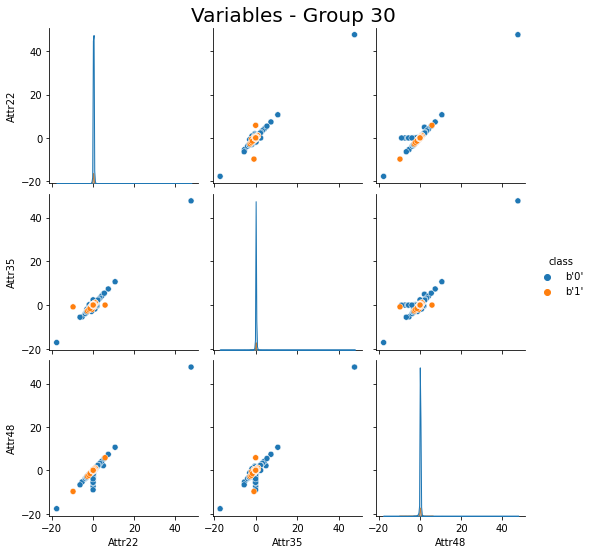

In [26]:
# Pairplot for Variables-Group 30
df_ = df[["Attr22","Attr35","Attr48","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 30", y = 1.02, fontsize = 20)
plt.show()

As seen in the above, there exists several outliers in different attributes that mislead the interpretation of the correlations. Because of this **we cannot select variables before imputing and cleaning the data**.

## Data Inputation

In [27]:
# We define the dataframe from where we are going to do modification
df_inputation = df_orig.copy(deep=True)

In [28]:
# Tolerance for interquartile range method
tolerance = 1.5

### Attribute 1

Descriptive Statistics - Attribute 1 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.05
Median: 	 	 	 0.04
Min: 	 	 	 	 -17.69
Max: 	 	 	 	 52.65
STD: 	 	 	 	 0.65
25%: 	 	 	 	 0.00
75%: 	 	 	 	 0.12
IQR (Q3-Q1): 	 	 	 0.12
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.18
Upper Range: 	 	 	 0.31
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 680.00
Outliers above: 	 	 586.00
Good Points: 	 	 	 9237.00


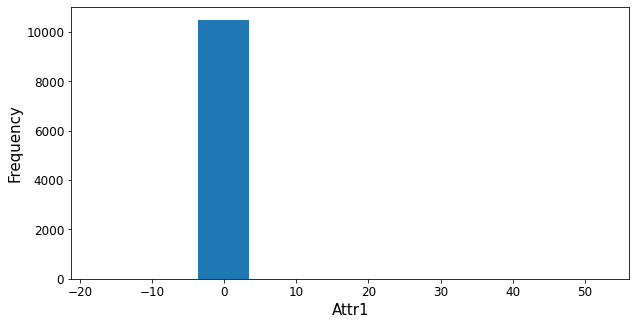

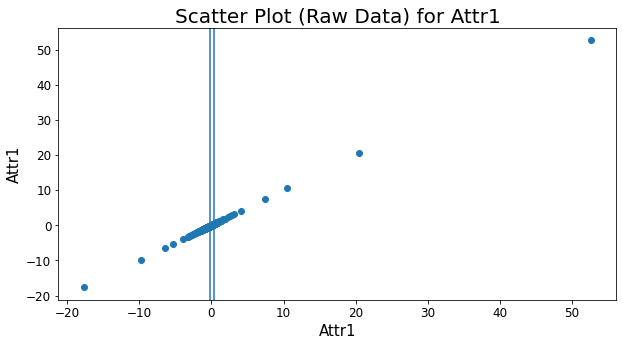

In [29]:
# Statistics and histogram
str_ = "Attr1"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 1","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [30]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-30-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-30-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.055132
std          0.087436
min         -0.183050
25%          0.008169
50%          0.043034
75%          0.101015
max          0.308150
Name: Attr1, dtype: float64

Descriptive Statistics - Attribute 1 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.06
Median: 	 	 	 0.04
Min: 	 	 	 	 -0.18
Max: 	 	 	 	 0.31
STD: 	 	 	 	 0.09
25%: 	 	 	 	 0.01
75%: 	 	 	 	 0.10
IQR (Q3-Q1): 	 	 	 0.09
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.13
Upper Range: 	 	 	 0.24
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 252.00
Outliers above: 	 	 368.00
Good Points: 	 	 	 9883.00


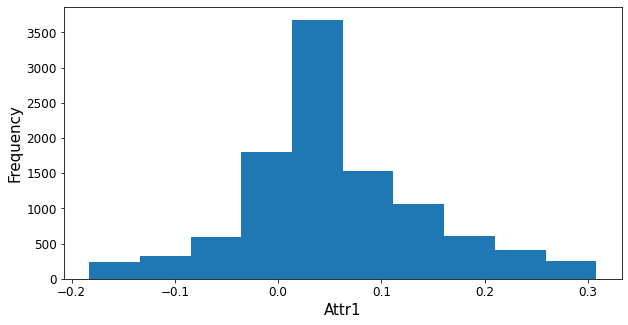

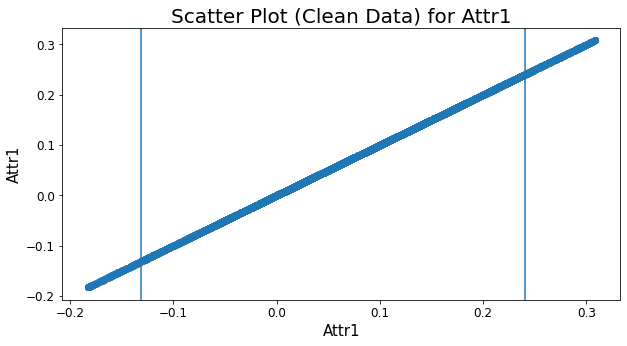

In [31]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr1"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 1","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 2

Descriptive Statistics - Attribute 2 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.62
Median: 	 	 	 0.46
Min: 	 	 	 	 0.00
Max: 	 	 	 	 480.73
STD: 	 	 	 	 6.43
25%: 	 	 	 	 0.25
75%: 	 	 	 	 0.69
IQR (Q3-Q1): 	 	 	 0.44
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.40
Upper Range: 	 	 	 1.34
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 290.00
Good Points: 	 	 	 10213.00


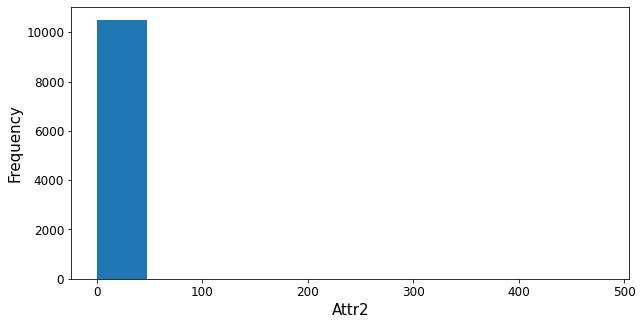

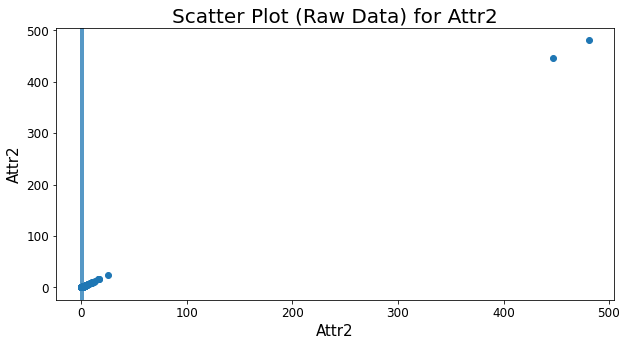

In [32]:
# Statistics and histogram
str_ = "Attr2"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 2","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [33]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-33-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-33-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.471526
std          0.270816
min          0.000000
25%          0.253955
50%          0.464140
75%          0.661980
max          1.341900
Name: Attr2, dtype: float64

Descriptive Statistics - Attribute 2 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.47
Median: 	 	 	 0.46
Min: 	 	 	 	 0.00
Max: 	 	 	 	 1.34
STD: 	 	 	 	 0.27
25%: 	 	 	 	 0.25
75%: 	 	 	 	 0.66
IQR (Q3-Q1): 	 	 	 0.41
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.36
Upper Range: 	 	 	 1.27
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 28.00
Good Points: 	 	 	 10475.00


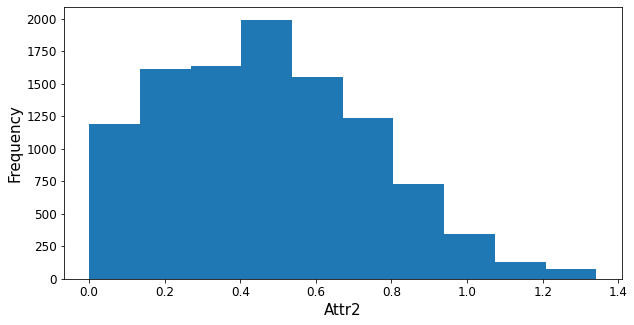

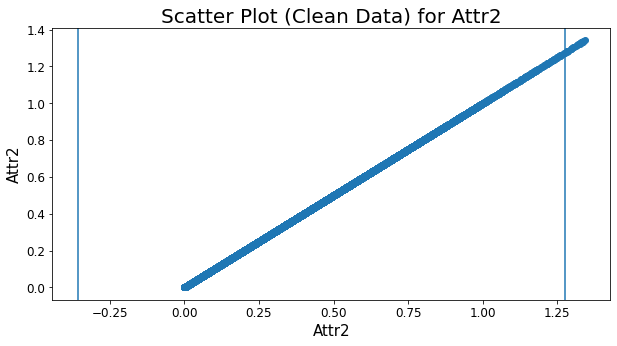

In [34]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr2"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 2","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 3

Descriptive Statistics - Attribute 3 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.10
Median: 	 	 	 0.20
Min: 	 	 	 	 -479.73
Max: 	 	 	 	 17.71
STD: 	 	 	 	 6.42
25%: 	 	 	 	 0.02
75%: 	 	 	 	 0.42
IQR (Q3-Q1): 	 	 	 0.40
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.59
Upper Range: 	 	 	 1.02
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 268.00
Outliers above: 	 	 3.00
Good Points: 	 	 	 10232.00


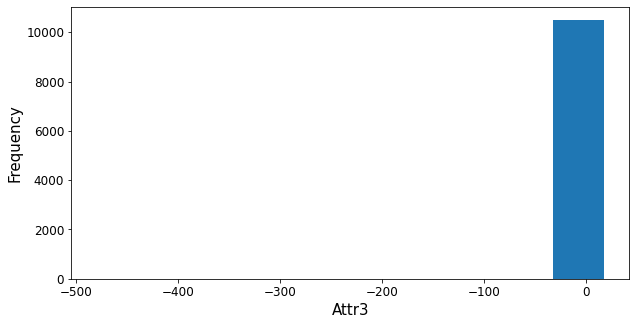

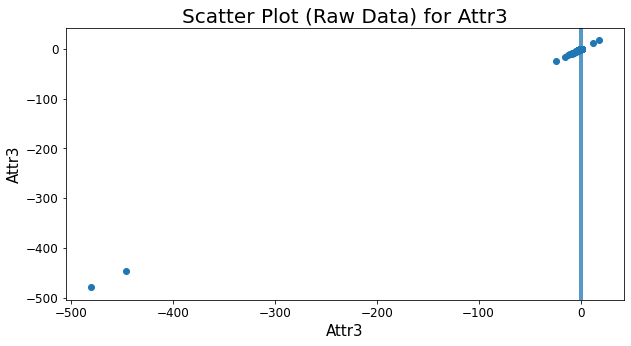

In [35]:
# Statistics and histogram
str_ = "Attr3"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 3","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [36]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-36-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-36-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.226989
std          0.287738
min         -0.583670
25%          0.038011
50%          0.198560
75%          0.419380
max          1.000000
Name: Attr3, dtype: float64

Descriptive Statistics - Attribute 3 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.23
Median: 	 	 	 0.20
Min: 	 	 	 	 -0.58
Max: 	 	 	 	 1.00
STD: 	 	 	 	 0.29
25%: 	 	 	 	 0.04
75%: 	 	 	 	 0.42
IQR (Q3-Q1): 	 	 	 0.38
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.53
Upper Range: 	 	 	 0.99
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 46.00
Outliers above: 	 	 18.00
Good Points: 	 	 	 10439.00


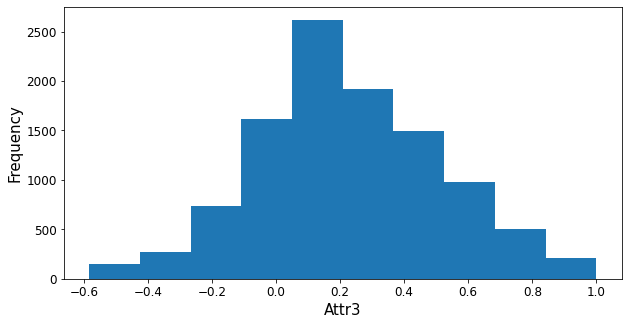

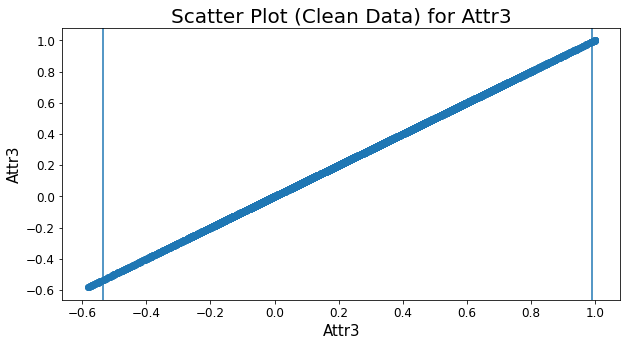

In [37]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr3"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 3","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 4

Descriptive Statistics - Attribute 4 

Count: 	 	 	 	 10485.00
Mean: 	 	 	 	 9.98
Median: 	 	 	 1.61
Min: 	 	 	 	 0.00
Max: 	 	 	 	 53433.00
STD: 	 	 	 	 523.69
25%: 	 	 	 	 nan
75%: 	 	 	 	 nan
IQR (Q3-Q1): 	 	 	 nan
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 nan
Upper Range: 	 	 	 nan
Count of NaN: 	 	 	 18.00
Outliers below: 	 	 0.00
Outliers above: 	 	 0.00
Good Points: 	 	 	 10485.00


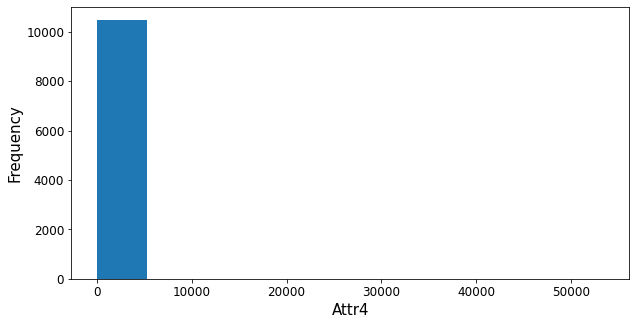

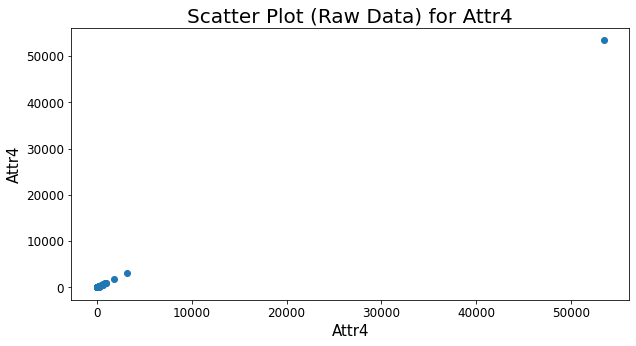

In [38]:
# Statistics and histogram
str_ = "Attr4"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 4","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

Descriptive Statistics - Attribute 4 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 9.97
Median: 	 	 	 1.61
Min: 	 	 	 	 0.00
Max: 	 	 	 	 53433.00
STD: 	 	 	 	 523.24
25%: 	 	 	 	 1.04
75%: 	 	 	 	 2.95
IQR (Q3-Q1): 	 	 	 1.91
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -1.83
Upper Range: 	 	 	 5.82
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 1118.00
Good Points: 	 	 	 9385.00


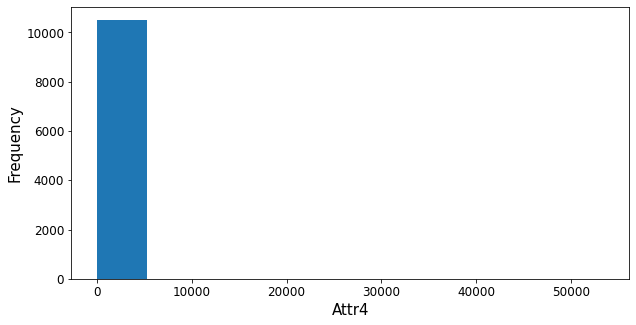

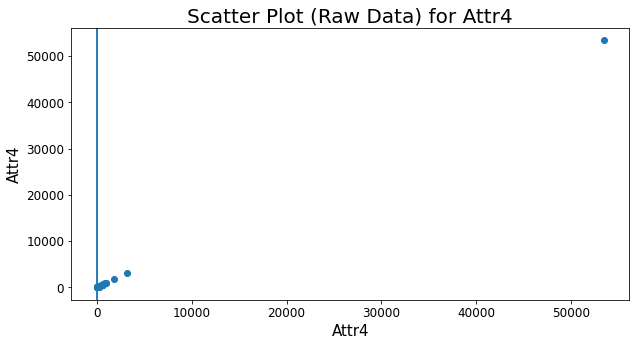

In [39]:
# Replace the NaN with the Median and take again the statistics
str_ = "Attr4"
median_ = df_inputation[str_].median()
df_inputation[str_] = df_inputation[str_].fillna(median_)

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 4","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [40]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-40-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-40-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         1.795439
std          1.136522
min          0.002080
25%          1.040900
50%          1.605600
75%          2.196600
max          5.818900
Name: Attr4, dtype: float64

Descriptive Statistics - Attribute 4 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 1.80
Median: 	 	 	 1.61
Min: 	 	 	 	 0.00
Max: 	 	 	 	 5.82
STD: 	 	 	 	 1.14
25%: 	 	 	 	 1.04
75%: 	 	 	 	 2.20
IQR (Q3-Q1): 	 	 	 1.16
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.69
Upper Range: 	 	 	 3.93
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 757.00
Good Points: 	 	 	 9746.00


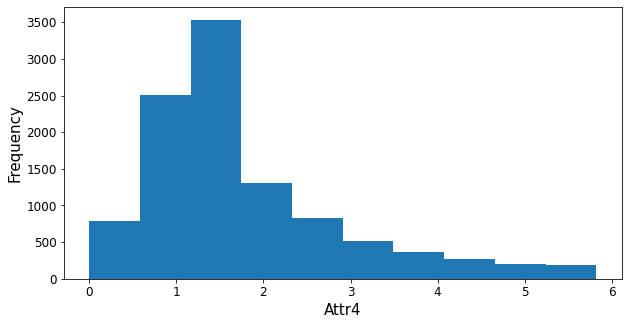

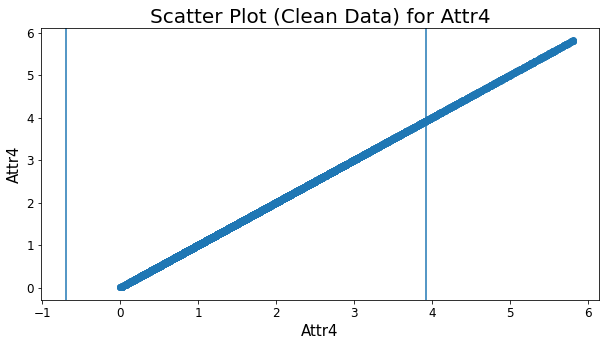

In [41]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr4"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 4","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 5

Descriptive Statistics - Attribute 5 

Count: 	 	 	 	 10478.00
Mean: 	 	 	 	 -1347.66
Median: 	 	 	 1.58
Min: 	 	 	 	 -11903000.00
Max: 	 	 	 	 685440.00
STD: 	 	 	 	 118580.57
25%: 	 	 	 	 nan
75%: 	 	 	 	 nan
IQR (Q3-Q1): 	 	 	 nan
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 nan
Upper Range: 	 	 	 nan
Count of NaN: 	 	 	 25.00
Outliers below: 	 	 0.00
Outliers above: 	 	 0.00
Good Points: 	 	 	 10478.00


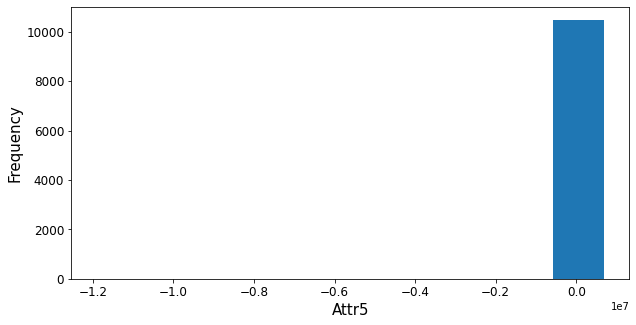

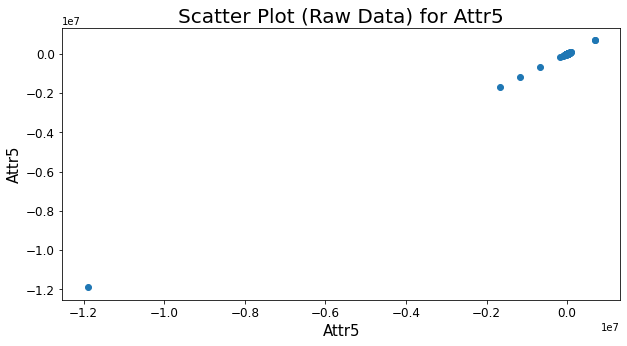

In [42]:
# Statistics and histogram
str_ = "Attr5"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 5","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

Descriptive Statistics - Attribute 5 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 -1344.45
Median: 	 	 	 1.58
Min: 	 	 	 	 -11903000.00
Max: 	 	 	 	 685440.00
STD: 	 	 	 	 118439.36
25%: 	 	 	 	 -51.96
75%: 	 	 	 	 55.88
IQR (Q3-Q1): 	 	 	 107.84
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -213.73
Upper Range: 	 	 	 217.65
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 764.00
Outliers above: 	 	 803.00
Good Points: 	 	 	 8936.00


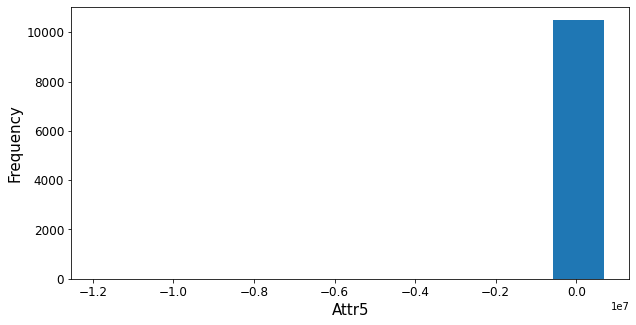

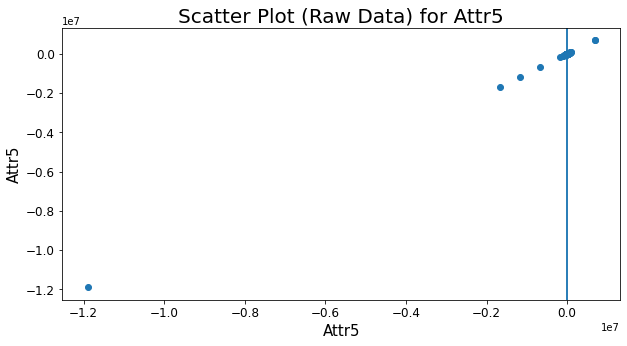

In [43]:
# Replace the NaN with the Median and take again the statistics
str_ = "Attr5"
median_ = df_inputation[str_].median()
df_inputation[str_] = df_inputation[str_].fillna(median_)

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 5","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [44]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-44-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-44-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         2.030768
std         69.911659
min       -213.500000
25%        -31.855500
50%          1.579300
75%         34.895500
max        217.510000
Name: Attr5, dtype: float64

Descriptive Statistics - Attribute 5 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 2.03
Median: 	 	 	 1.58
Min: 	 	 	 	 -213.50
Max: 	 	 	 	 217.51
STD: 	 	 	 	 69.91
25%: 	 	 	 	 -31.86
75%: 	 	 	 	 34.90
IQR (Q3-Q1): 	 	 	 66.75
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -131.98
Upper Range: 	 	 	 135.02
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 430.00
Outliers above: 	 	 458.00
Good Points: 	 	 	 9615.00


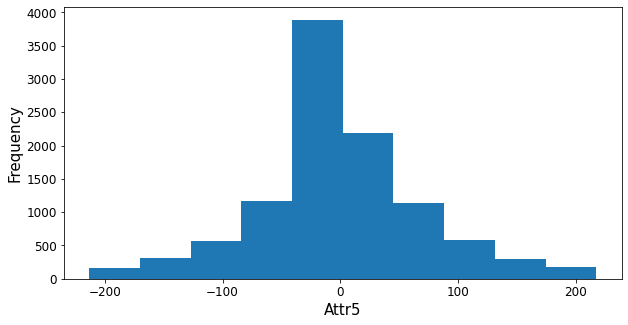

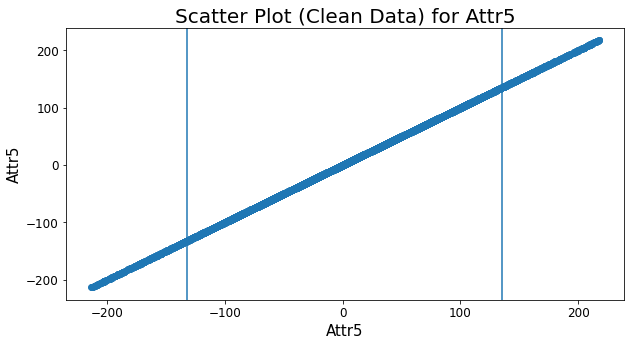

In [45]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr5"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 5","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 6

Descriptive Statistics - Attribute 6 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 -0.12
Median: 	 	 	 0.00
Min: 	 	 	 	 -508.12
Max: 	 	 	 	 45.53
STD: 	 	 	 	 6.97
25%: 	 	 	 	 0.00
75%: 	 	 	 	 0.07
IQR (Q3-Q1): 	 	 	 0.07
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.11
Upper Range: 	 	 	 0.18
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 1406.00
Outliers above: 	 	 1764.00
Good Points: 	 	 	 7333.00


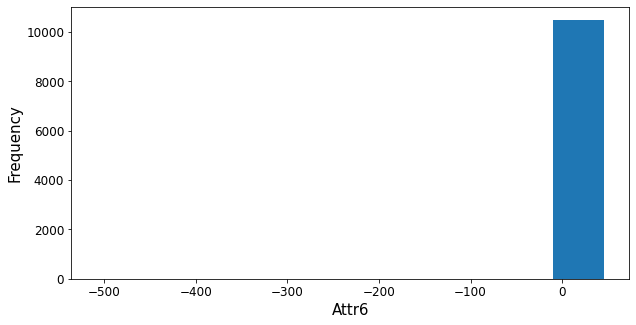

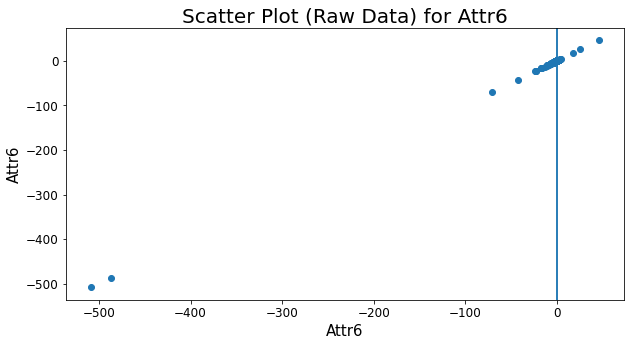

In [46]:
# Statistics and histogram
str_ = "Attr6"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 6","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [47]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-47-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-47-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.008607
std          0.040741
min         -0.108380
25%          0.000000
50%          0.000000
75%          0.000000
max          0.181390
Name: Attr6, dtype: float64

Descriptive Statistics - Attribute 6 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.01
Median: 	 	 	 0.00
Min: 	 	 	 	 -0.11
Max: 	 	 	 	 0.18
STD: 	 	 	 	 0.04
25%: 	 	 	 	 0.00
75%: 	 	 	 	 0.00
IQR (Q3-Q1): 	 	 	 0.00
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 0.00
Upper Range: 	 	 	 0.00
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 1095.00
Outliers above: 	 	 1759.00
Good Points: 	 	 	 7649.00


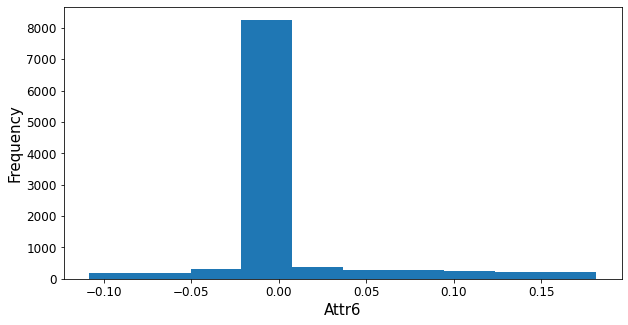

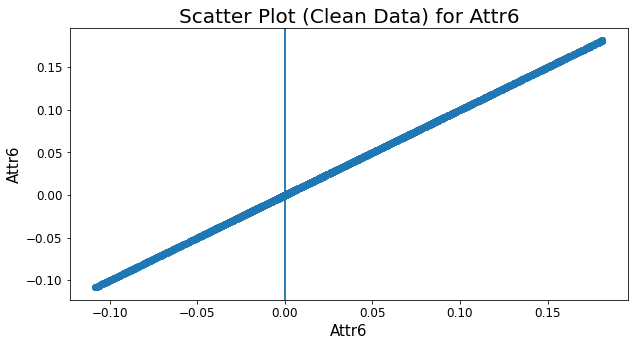

In [48]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr6"
Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 6","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 7

Descriptive Statistics - Attribute 7 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.07
Median: 	 	 	 0.05
Min: 	 	 	 	 -17.69
Max: 	 	 	 	 52.65
STD: 	 	 	 	 0.65
25%: 	 	 	 	 0.00
75%: 	 	 	 	 0.14
IQR (Q3-Q1): 	 	 	 0.14
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.21
Upper Range: 	 	 	 0.35
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 591.00
Outliers above: 	 	 548.00
Good Points: 	 	 	 9364.00


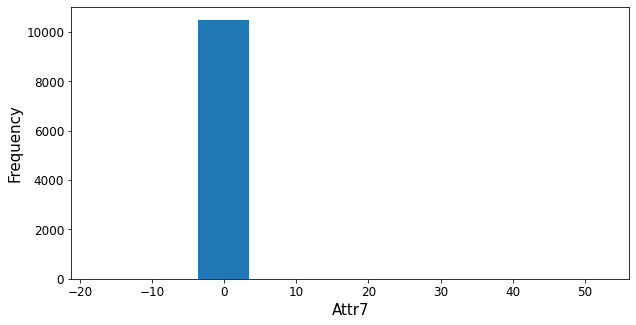

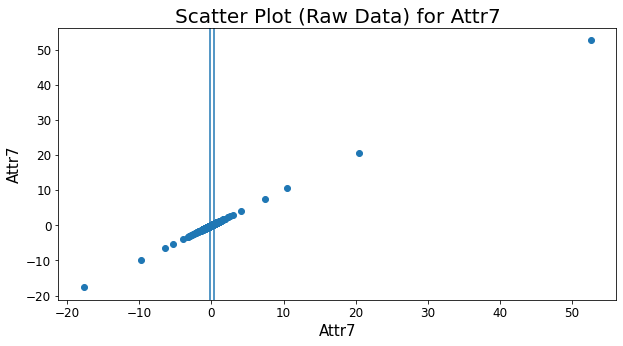

In [49]:
# Statistics and histogram
str_ = "Attr7"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 7","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [50]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-50-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-50-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.064839
std          0.100878
min         -0.207790
25%          0.010156
50%          0.050945
75%          0.119485
max          0.352220
Name: Attr7, dtype: float64

Descriptive Statistics - Attribute 7 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.06
Median: 	 	 	 0.05
Min: 	 	 	 	 -0.21
Max: 	 	 	 	 0.35
STD: 	 	 	 	 0.10
25%: 	 	 	 	 0.01
75%: 	 	 	 	 0.12
IQR (Q3-Q1): 	 	 	 0.11
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.15
Upper Range: 	 	 	 0.28
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 231.00
Outliers above: 	 	 330.00
Good Points: 	 	 	 9942.00


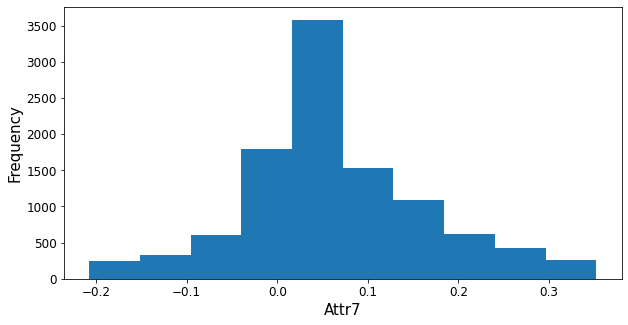

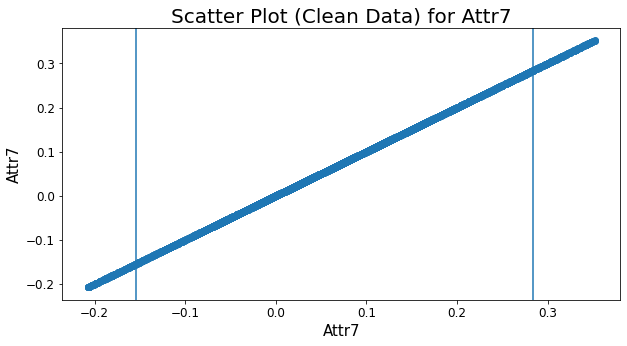

In [51]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr7"
Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 7","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 8

Descriptive Statistics - Attribute 8 

Count: 	 	 	 	 10489.00
Mean: 	 	 	 	 19.14
Median: 	 	 	 1.11
Min: 	 	 	 	 -2.08
Max: 	 	 	 	 53432.00
STD: 	 	 	 	 717.76
25%: 	 	 	 	 nan
75%: 	 	 	 	 nan
IQR (Q3-Q1): 	 	 	 nan
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 nan
Upper Range: 	 	 	 nan
Count of NaN: 	 	 	 14.00
Outliers below: 	 	 0.00
Outliers above: 	 	 0.00
Good Points: 	 	 	 10489.00


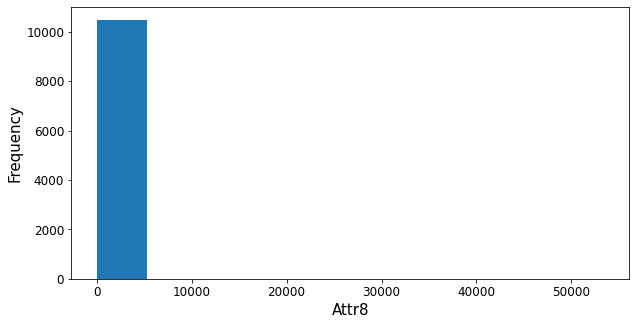

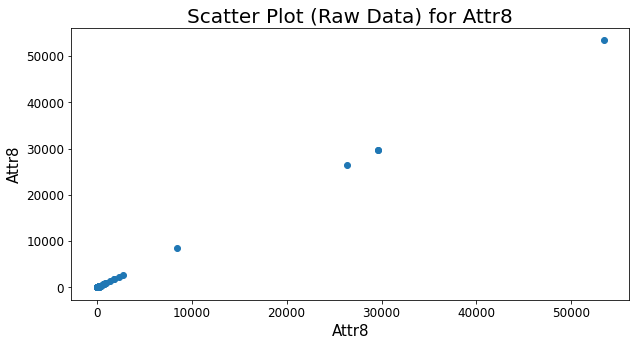

In [52]:
# Statistics and histogram
str_ = "Attr8"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 8","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

Descriptive Statistics - Attribute 8 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 19.12
Median: 	 	 	 1.11
Min: 	 	 	 	 -2.08
Max: 	 	 	 	 53432.00
STD: 	 	 	 	 717.28
25%: 	 	 	 	 0.43
75%: 	 	 	 	 2.85
IQR (Q3-Q1): 	 	 	 2.42
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -3.20
Upper Range: 	 	 	 6.48
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 1150.00
Good Points: 	 	 	 9353.00


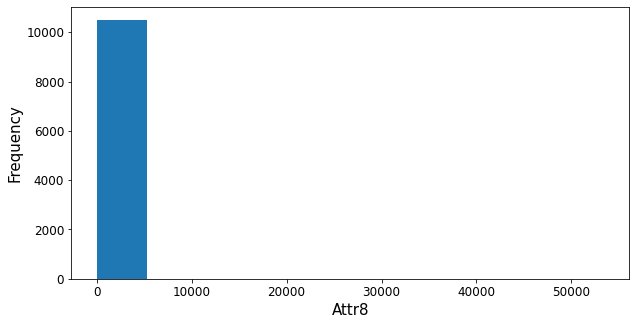

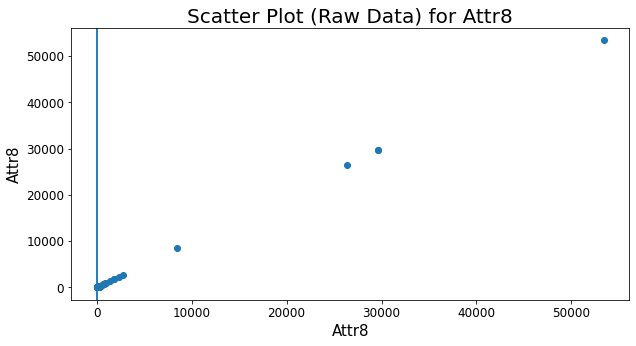

In [53]:
# Replace the NaN with the Median and take again the statistics
str_ = "Attr8"
median_ = df_inputation[str_].median()
df_inputation[str_] = df_inputation[str_].fillna(median_)

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 8","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [54]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-54-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-54-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         1.376627
std          1.396961
min         -2.081800
25%          0.431935
50%          1.111000
75%          1.807250
max          6.475400
Name: Attr8, dtype: float64

Descriptive Statistics - Attribute 8 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 1.38
Median: 	 	 	 1.11
Min: 	 	 	 	 -2.08
Max: 	 	 	 	 6.48
STD: 	 	 	 	 1.40
25%: 	 	 	 	 0.43
75%: 	 	 	 	 1.81
IQR (Q3-Q1): 	 	 	 1.38
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -1.63
Upper Range: 	 	 	 3.87
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 1.00
Outliers above: 	 	 852.00
Good Points: 	 	 	 9650.00


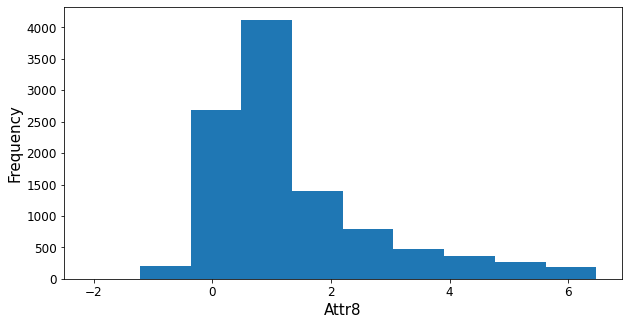

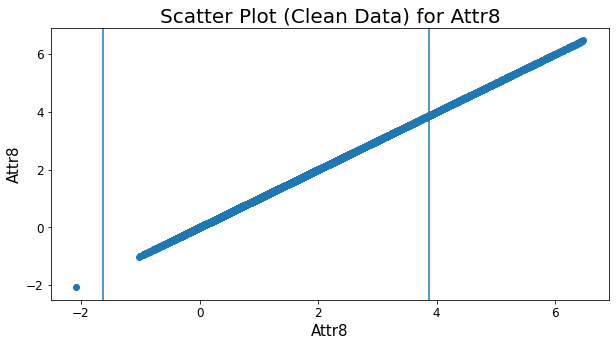

In [55]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr8"
Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 8","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 9

Descriptive Statistics - Attribute 9 

Count: 	 	 	 	 10500.00
Mean: 	 	 	 	 1.82
Median: 	 	 	 1.20
Min: 	 	 	 	 -1.22
Max: 	 	 	 	 740.44
STD: 	 	 	 	 7.58
25%: 	 	 	 	 nan
75%: 	 	 	 	 nan
IQR (Q3-Q1): 	 	 	 nan
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 nan
Upper Range: 	 	 	 nan
Count of NaN: 	 	 	 3.00
Outliers below: 	 	 0.00
Outliers above: 	 	 0.00
Good Points: 	 	 	 10500.00


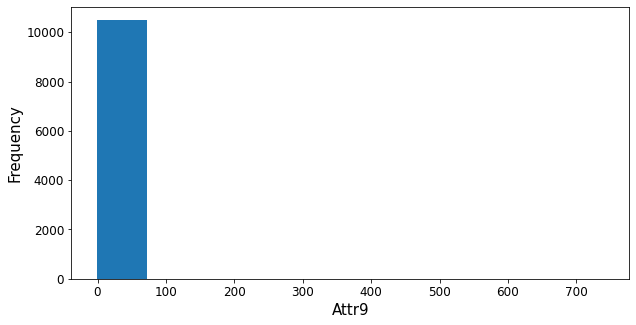

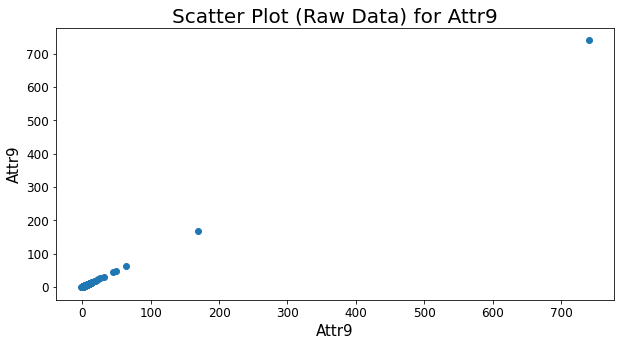

In [56]:
# Statistics and histogram
str_ = "Attr9"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 9","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

Descriptive Statistics - Attribute 9 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 1.82
Median: 	 	 	 1.20
Min: 	 	 	 	 -1.22
Max: 	 	 	 	 740.44
STD: 	 	 	 	 7.58
25%: 	 	 	 	 1.01
75%: 	 	 	 	 2.06
IQR (Q3-Q1): 	 	 	 1.05
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.56
Upper Range: 	 	 	 3.63
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 1.00
Outliers above: 	 	 725.00
Good Points: 	 	 	 9777.00


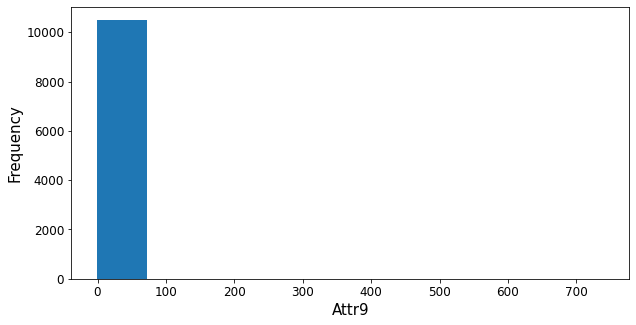

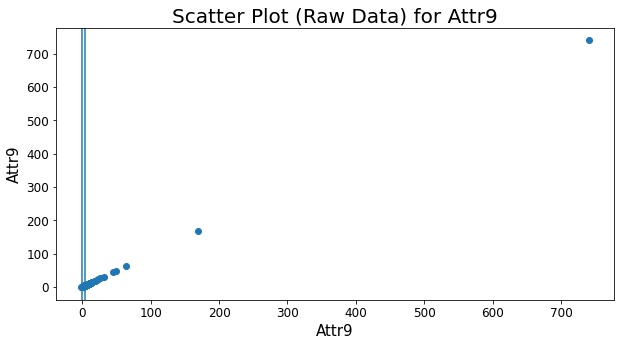

In [57]:
# Replace the NaN with the Median and take again the statistics
str_ = "Attr9"
median_ = df_inputation[str_].median()
df_inputation[str_] = df_inputation[str_].fillna(median_)

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 9","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [58]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-58-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-58-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         1.416892
std          0.712609
min         -0.000084
25%          1.011450
50%          1.199000
75%          1.761550
max          3.628800
Name: Attr9, dtype: float64

Descriptive Statistics - Attribute 9 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 1.42
Median: 	 	 	 1.20
Min: 	 	 	 	 -0.00
Max: 	 	 	 	 3.63
STD: 	 	 	 	 0.71
25%: 	 	 	 	 1.01
75%: 	 	 	 	 1.76
IQR (Q3-Q1): 	 	 	 0.75
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.11
Upper Range: 	 	 	 2.89
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 0.00
Outliers above: 	 	 590.00
Good Points: 	 	 	 9913.00


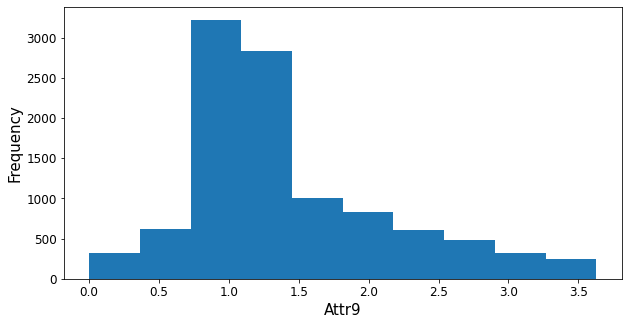

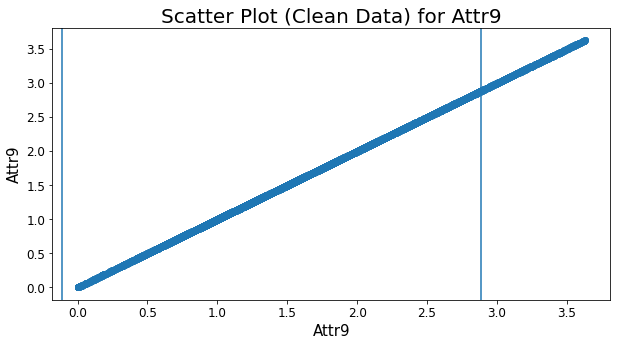

In [59]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr9"
Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 9","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Attribute 10

Descriptive Statistics - Attribute 10 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.37
Median: 	 	 	 0.52
Min: 	 	 	 	 -479.73
Max: 	 	 	 	 11.84
STD: 	 	 	 	 6.43
25%: 	 	 	 	 0.30
75%: 	 	 	 	 0.73
IQR (Q3-Q1): 	 	 	 0.43
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.35
Upper Range: 	 	 	 1.37
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 299.00
Outliers above: 	 	 6.00
Good Points: 	 	 	 10198.00


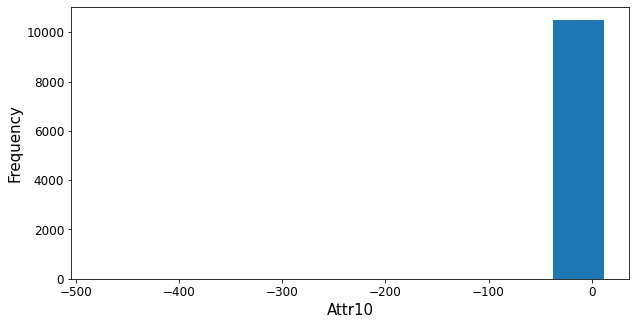

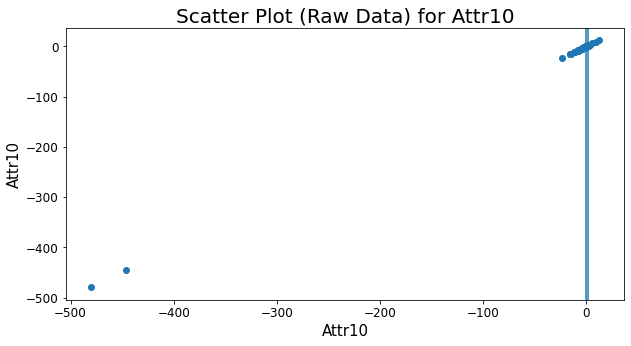

In [60]:
# Statistics and histogram
str_ = "Attr10"

Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 10","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Raw Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

In [61]:
# Replace the outlier values and NaN with the Median
median_ = df_inputation[str_].median()
df_inputation[str_][df_inputation[str_]<lower_range] = median_
df_inputation[str_][df_inputation[str_]>upper_range] = median_
df_inputation[str_] = df_inputation[str_].fillna(median_)
df_inputation[str_].describe()

<ipython-input-61-3225d854958c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]<lower_range] = median_
<ipython-input-61-3225d854958c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputation[str_][df_inputation[str_]>upper_range] = median_


count    10503.000000
mean         0.512450
std          0.268852
min         -0.344980
25%          0.322885
50%          0.515500
75%          0.725115
max          1.000000
Name: Attr10, dtype: float64

Descriptive Statistics - Attribute 10 

Count: 	 	 	 	 10503.00
Mean: 	 	 	 	 0.51
Median: 	 	 	 0.52
Min: 	 	 	 	 -0.34
Max: 	 	 	 	 1.00
STD: 	 	 	 	 0.27
25%: 	 	 	 	 0.32
75%: 	 	 	 	 0.73
IQR (Q3-Q1): 	 	 	 0.40
Tolerance for IQR: 	 	 1.50
Lower Range: 	 	 	 -0.28
Upper Range: 	 	 	 1.33
Count of NaN: 	 	 	 0.00
Outliers below: 	 	 26.00
Outliers above: 	 	 0.00
Good Points: 	 	 	 10477.00


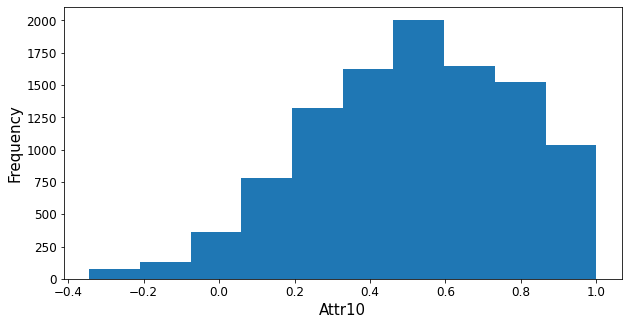

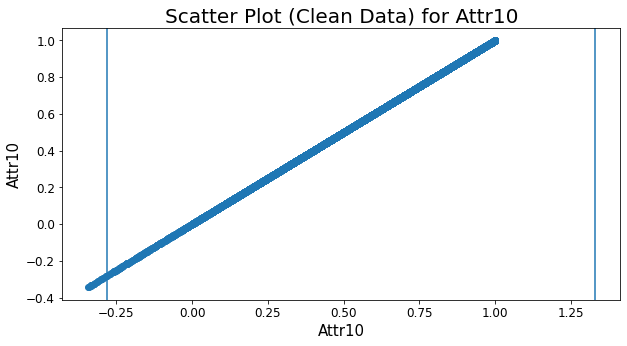

In [62]:
# Statistics and histogram without NaN and Outliers
str_ = "Attr10"
Q1 = np.percentile(df_inputation[str_],25)
Q3 = np.percentile(df_inputation[str_],75)
IQR = Q3-Q1
lower_range = Q1-tolerance*IQR
upper_range = Q3+tolerance*IQR

print("Descriptive Statistics - Attribute 10","\n")
print("Count: \t \t \t \t {0:.2f}".format(df_inputation[str_].count()))
print("Mean: \t \t \t \t {0:.2f}".format(df_inputation[str_].mean()))
print("Median: \t \t \t {0:.2f}".format(df_inputation[str_].median()))
print("Min: \t \t \t \t {0:.2f}".format(df_inputation[str_].min()))
print("Max: \t \t \t \t {0:.2f}".format(df_inputation[str_].max()))
print("STD: \t \t \t \t {0:.2f}".format(df_inputation[str_].std()))
print("25%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],25)))
print("75%: \t \t \t \t {0:.2f}".format(np.percentile(df_inputation[str_],75)))
print("IQR (Q3-Q1): \t \t \t {0:.2f}".format(IQR))
print("Tolerance for IQR: \t \t {0:.2f}".format(tolerance))
print("Lower Range: \t \t \t {0:.2f}".format(lower_range))
print("Upper Range: \t \t \t {0:.2f}".format(upper_range))
print("Count of NaN: \t \t \t {0:.2f}".format(df_inputation[str_].isna().sum()))
print("Outliers below: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]<lower_range].count()))
print("Outliers above: \t \t {0:.2f}".format(df_inputation[str_][df_inputation[str_]>upper_range].count()))
print("Good Points: \t \t \t {0:.2f}".format(df_inputation[str_].count()-df_inputation[str_][df_inputation[str_]<lower_range].count()-df_inputation[str_][df_inputation[str_]>upper_range].count()))

plt.figure(figsize=(10,5))
plt.hist(df_inputation[str_],bins=10)
plt.ylabel('Frequency', fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.figure(figsize=(10,5))
plt.scatter(df_inputation[str_],df_inputation[str_])
plt.axvline(lower_range, 0, 1)
plt.axvline(upper_range, 0, 1)
plt.title('Scatter Plot (Clean Data) for '+str_, fontsize=20)
plt.ylabel(str_, fontsize=15)
plt.xlabel(str_, fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()